# CCD Lab - Pleiades

#### For this CCD lab we sought to image the Pleiades Star Cluster Using Stony Brook's 14" Meade LX200 ACF telescope. To do so we captured a series of dark frames, flat field images, and our target images in each of the RGB filters. The following code will analyze how we manipulated the images obtained to generate our final image shown below.

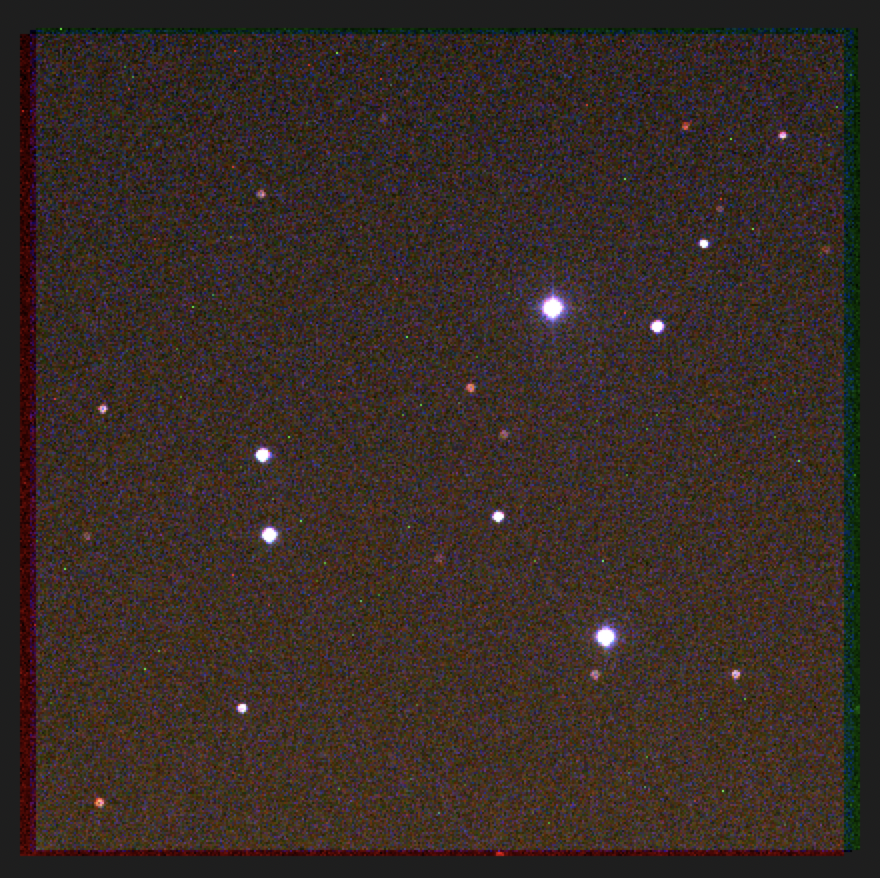

#### To begin, we import the necessary packages that will allow us to perform the operations needed. Numpy allows us to use a variety of array features and mathematical operations. Matplotlib will allows us to plot the images we captured. Astropy will allow us to read and work with .FITS type files. Scipy, glob, and os are for convinience is opening and writing new files.

In [1]:
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

from astropy.io import fits

from scipy import stats
from scipy.stats import norm
from scipy.stats import linregress

import glob
import os

##### Here we define variables that we will need to upload into Python. These variables are assigned a path that will allow Python the search that path looking for the files that we want to work with. The * tells the code to include all file numbers with the same name.

In [2]:
darks1 = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/Flat_Fields/P_darks_1s/*'
darks01 = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/Flat_Fields/P_darks_0.1s/*'
blue_flat = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/Flat_Fields/P_blue_flat/*'
red_flat = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/Flat_Fields/P_red_flat/*'
green_flat = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/Flat_Fields/P_visible_flat/*'
arclamp = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/3.4.6 Arc Lamp Spec/ \
lab1_arclamp_flat_field_.00000001.FIT'
neon = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/3.4.6 Arc Lamp Spec/ \
lab1_arclamp_spectrum.00000001.FIT'
long_darks = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/ \
lab1_series_dark_frame_.*.DARK.FIT'
temp_bias_darks = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/lab1_temp_*.FIT'

## 4.1 Bias Frames

### 4.1.1. Here we will begin our Data Analysis by creating a histogram of the distribution of counts using our bias frame taken at 0 degrees C

#### We open our bias frame using astropiy's fits class. Then we flatten our 2D array into a 1D array and call it "countvalues". We need a 1D array to plot the histogram. It is also important to know what the maximum and minimum count values in the array are so we know what to expect our x-range to be.

max count value: 16464
min count value: 998
mean: 1040.986572265625
mode: 1041
median: 1041.0
std: 21.25370390392048


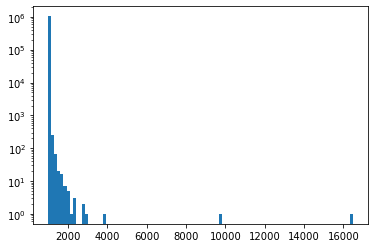

In [3]:
###  opens the bias FITS file
hdulist = fits.open\
(r'/Users/adamfletcher/Desktop/lab1_temp_bias.00000001.BIAS.FIT')
imagedata = hdulist[0].data

### make 1D array
countvalues = imagedata.flatten()

print(f'max count value: {np.max(countvalues)}')
print(f'min count value: {np.min(countvalues)}')

### plot the histogram, using a logarithmic y-axis
plt.hist(countvalues,bins=100);
plt.yscale('log')

### compute the mean, the median, the mode, and std:
print(f'mean: {np.mean(countvalues)}')
print(f'mode: {stats.mode(countvalues)[0][0]}')
print(f'median: {np.median(countvalues)}')
print(f'std: {np.std(countvalues)}')

#### Lets truncate all the count values greater than 1800 and we will output the mean, median, mode, and standard deviation from the plot now after clipping the values greater than 2000. Clippedvalues will represent all values less than 2000.

mean: 1040.950169040546
mode: 1041
median: 1041.0
std: 11.357665477488213


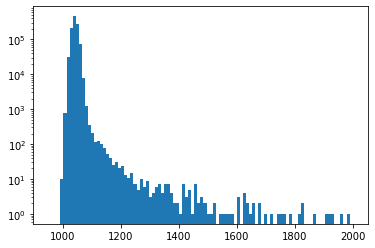

In [4]:
### plot a histogram, using a logarithmic y-axis
plt.hist(countvalues,range=[950,2000], bins=100);
plt.yscale('log')

clippedvalues = countvalues[countvalues<2050]

### compute the mean, median, mode, and std clipped pix
print(f'mean: {np.mean(clippedvalues)}')
print(f'mode: {stats.mode(clippedvalues)[0][0]}')
print(f'median: {np.median(clippedvalues)}')
print(f'std: {np.std(clippedvalues)}')

#### The hot pixels are these outliers that we see outside of the main Gaussian curve between 1000 and 2000. The fraction of these hot pixels rejected can be found by dividing the clipped values from the total countvalues, multiplying by 100, and then subtracting that from 100. We see that the fraction of pixels rejected is 0.001%

In [5]:
frac = 100 - (len(clippedvalues)/len(countvalues) *100)
frac

0.001049041748046875

### 4.1.2. Next we want to obtain and plot a relatively well-fitting Gaussian distribution to describe the bulk of the count data. From the count values within this Gaussian range we will again determine the mean and the std.

mean: 1040.8614810878573
std: 9.831100020347098


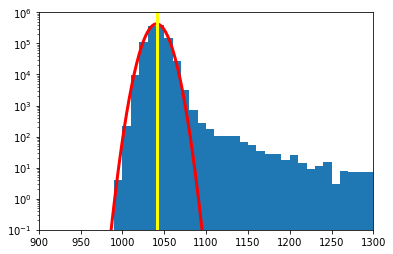

In [6]:
### overplot a normal distribution, as specified by
### the mean and standard deviation

cmin=900
cmax=1900
nbins=100
normalization=(cmax-cmin)/nbins*len(countvalues\
        [(countvalues>=cmin) & (countvalues<=cmax)])

clipmin=cmin
clipmax=1150
clippedvalues = countvalues[(countvalues>=clipmin)\
                        & (countvalues<=clipmax)]

mu=np.mean(clippedvalues)
sig=np.std(clippedvalues)
print('mean:', mu)
print('std:', sig)

mode=stats.mode(clippedvalues)[0][0]

xarray=np.linspace(cmin,cmax,nbins*10)
yarray=normalization*norm.pdf(xarray,loc=mu, scale=sig)

plt.hist(countvalues,range=[cmin,cmax], bins=nbins);
plt.yscale('log')
plt.xlim([900, 1300])
plt.ylim([0.1,1e6])
plt.plot(xarray,yarray,color="red",linewidth=3.0)
plt.axvline(x=mode,linewidth=3.0,color="yellow")

#### The std is a measure of the read noise in units of counts. From looking at the header file we see that the gain of the CCD is 2.06. Using our equation: 

$gain = \frac{N(electrons)}{N(counts)}$

#### we can convert our measure of read noise into units of electrons. 

In [7]:
gain = 2.06

N_electrons = gain * sig
print(f'Read Noise: {N_electrons} e-')
print('The manufactures description: 14.8 e-')
print('This read noise we calculated is consistent with \
the manufacturer less only 5 electrons')

Read Noise: 20.252066041915022 e-
The manufactures description: 14.8 e-
This read noise we calculated is consistent with the manufacturer less only 5 electrons


## 4.2 Dark Frames

### 4.2.1. Our first task in actually making our nice picture is to combine each of our dark frames. 

#### There are about 5 different images taken for each catergory and this function below will read in the files of each catergory using the path names we defined above, save each image as a 2D array, and then assign each array to a new array. The values of each array are the "count" values associated with that pixel. The count is a measure of how many electrons were read by that pixel. Higher counts means more light hitting that pixel.

#### The code will then stack the arrays on top of each other. Then, using the numpy "median" function we will take the median of each pixel from all 5 images creating one master dark image. 

#### The resulting will be plotted after successful execution of the code. The purpose of this is to reduce the back ground noise of the images and to identify hot pixels in the CCD (pixels that are spontaneously transferring electrons even when not acted upon). This function will be used for the dark frames which were taken at 0.1 second and 1 second cadences. It will also record and output the mean and standard deviation of the images. 

In [8]:
### Function creates a 3D numpy array of a stack of images 
### and makes 1 image by taking the mean of the points 
### through 1 axis returning a 2D array ###

def med_image(a):
    files = []

    for name in glob.glob(a):
        hdulist = fits.open(name)
        data = hdulist[0].data
        files.append(data)
        
        mean = np.mean(data)
        std = np.std(data)
            
    print(f'mean:{mean}')
    print(f'std:{std}')
        
    files_array = np.array(files)

    master = np.median(files_array, axis=0)
    

    plt.imshow(master, vmin=mean - 1*std, vmax=mean + 1*std)
    plt.title(f"Color Image of Median Values")
    plt.colorbar()
    plt.show()
    
    return master

mean:994.2882852554321
std:21.144806093331713


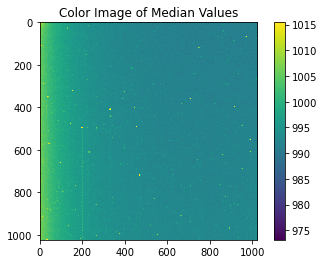

In [9]:
### Master Darks 1 sec ###
dark_1sec = med_image(darks1)

mean:996.9927272796631
std:12.549142465445081


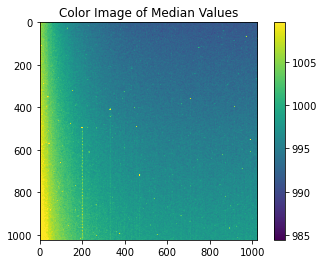

In [10]:
### Master Darks 0.1 seconds ###
dark_01sec = med_image(darks01)

#### As we see the above master dark frame is smoother and less noisy than the 0.1 second frame. This is because with a longer exposure time we gathered clearer and a more precise number of counts from each pixel that allowed for a smoother noise reduction. 

#### The bright spots we see scattered throughout are known as hot pixels. These are pixels that are registering a signal where there is no signal because the cap was blocking the lens of the camera. These are spontaneous electrons that are moving between the plates of the semi-conductor. This is an issue because they give the impression of a light source in those areas where no light source may actually be. 

#### This code outputs the final median image, but if we look at each individual dark frame we see some have hot pixels where others do not. This could be in large due to the effect of cosmic rays in the atmosphere passing into our semi-conductor and causing it to read an event. So, this may appear in one frame but not another.

#### These frames will be subtracted from our flat fields helping to eliminate the noise and effects of hot pixels.

### 4.2.2. For this section data for the 1 second long dark exposure will be analyzed
#### Statistical Uncertainty of the mean counts

In [11]:
# Calculate the statistical uncertainty on the mean counts
n_pixels = len(clippedvalues)  
su = 21.1448 / np.sqrt(n_pixels)

print(f'Statistical Uncertainty: {su}')



Statistical Uncertainty: 0.020653030328915536


#### Systematic Uncertainty

In [12]:
# Define different percentile ranges to estimate 
# systematic uncertainty
percentile_ranges = [(1, 99), (5, 95), (10, 90)]


# Iterate through different percentile ranges
for p_min, p_max in percentile_ranges:
    # Define a cut to limit the range of count values
    clipmin2 = np.percentile(countvalues, p_min)
    clipmax2 = np.percentile(countvalues, p_max)
    clippedvalues2 = countvalues[(countvalues >= \
                clipmin2) & (countvalues <= clipmax2)]
    
# Compute the mean and standard deviation of the clipped values
mean_value2 = np.mean(clippedvalues2)
std_dev = np.std(clippedvalues2)

# Calculate the statistical uncertainty on the mean counts (SEM)
sem = std_dev / np.sqrt(n_pixels)

# Print the results for each percentile range
print(f"Percentile Range {p_min}-{p_max}: Mean = {mean_value2},\
Standard Deviation = {std_dev}, SEM = {sem}")
    
print()

Percentile Range 10-90: Mean = 1040.6599038352915,Standard Deviation = 6.401287974884503, SEM = 0.0062524116893710015



#### As we can see, the systematic uncertainty yields only 0.006, while statistical uncertainty yields 0.0206, so that is the dominating uncertainty with for our data set.

### Plot Mean counts v. Exposure Time

In [13]:
from scipy.stats import sem

# Initialize lists to store 
# exposure times, mean counts, 
# and uncertainties

exposure_times = []
mean_counts = []
uncertainties = []



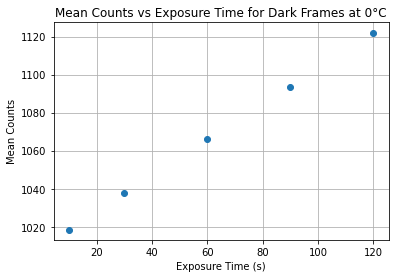

In [14]:
for name in glob.glob(long_darks):
    hdulist = fits.open(name)
    data = hdulist[0].data
    header = hdulist[0].header
    
    # Extract exposure time from header and 
    # append to the list
    exposure_time = header['EXPTIME']
    exposure_times.append(exposure_time)
    
    # Compute the mean counts of the image and 
    # append to the list
    mean_count = np.mean(data)
    mean_counts.append(mean_count)
    
    # Compute the statistical uncertainty on the 
    # mean counts and append to the list
    uncertainty = sem(data.flatten())
    uncertainties.append(uncertainty)
        

# Plotting the mean counts against exposure 
# time with error bars
plt.errorbar(exposure_times, mean_counts, \
             yerr=uncertainties, fmt='o')
plt.xlabel('Exposure Time (s)')
plt.ylabel('Mean Counts')
plt.title('Mean Counts vs Exposure Time for Dark \
Frames at 0°C')
plt.grid(True)
plt.show()



In [15]:
print(f'Uncertainties for each dark frame (30,90,10,60,120 \
seconds): {uncertainties}')
print(f'Exposure Times: {exposure_times}')
print(f'Mean Counts: {mean_counts}')

Uncertainties for each dark frame (30,90,10,60,120 seconds): [0.15965390891532152, 0.35151897235785673, 0.09394547155034487, 0.26715748696700037, 0.4274834274331873]
Exposure Times: [30.0, 90.0, 10.0, 60.0, 120.0]
Mean Counts: [1037.6417026519775, 1093.684471130371, 1018.4285764694214, 1065.9096212387085, 1121.817910194397]


### Linear Regression

In [16]:
# Perform linear regression
slope, intercept, r_value, p_value, std_err = \
linregress(exposure_times, mean_counts)

# Print the results
print("Slope:", slope)
print("Intercept:", intercept)
print("R-squared:", r_value**2)

Slope: 0.9383203399968028
Intercept: 1009.3205952571734
R-squared: 0.999970223958381


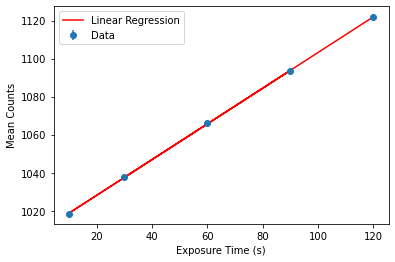

In [17]:
# Plot the original data points with error bars 
# (if uncertainties are available)
plt.errorbar(exposure_times, mean_counts, \
        yerr=uncertainties, fmt='o', label='Data')

# Plot the linear regression line
regression_line = [slope * x + intercept for x in \
                   exposure_times]
plt.plot(exposure_times, regression_line, \
         label='Linear Regression', color='red')

# Label the axes and show a legend
plt.xlabel('Exposure Time (s)')
plt.ylabel('Mean Counts')
plt.legend()

# Show the plot
plt.show()

### Second Plot of residual data points

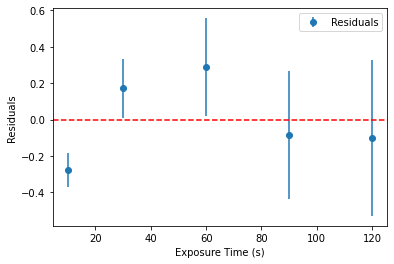

In [18]:
# Calculate the predicted values of linear regression
predicted_counts = [slope * time + intercept for time \
                    in exposure_times]

# Calculate the residuals
residuals = [observed - predicted for observed, \
        predicted in zip(mean_counts, predicted_counts)]

# Plot the residuals with error bars
plt.errorbar(exposure_times, residuals, \
             yerr=uncertainties, fmt='o', label='Residuals')
# Draw a horizontal line at y=0 to show 
# the deviation of residuals

plt.axhline(y=0, color='r', linestyle='--')
# Label the axes and show a legend
plt.xlabel('Exposure Time (s)')
plt.ylabel('Residuals')
plt.legend()

# Show the plot
plt.show()

### Dark Current in Electrons per pixel per second at 0 degrees C

In [19]:
# Given values
gain = 2.06

# Calculate the dark current
dark_current = slope * gain  # electrons/pixel/second

print("Dark Current:", dark_current, "electrons/pixel/second")
print("Manufacturer: 9.0 electrons/pixel/second")

Dark Current: 1.9329399003934138 electrons/pixel/second
Manufacturer: 9.0 electrons/pixel/second


### Dark Current at 10 degrees C

Slope (Dark Current in ADU/s): 3.902524391810099


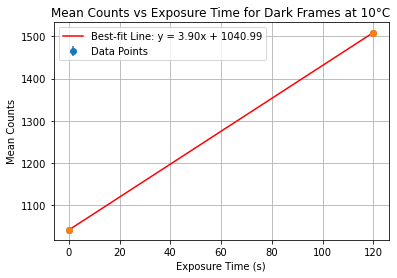

In [20]:
# Initialize lists to store exposure times, mean counts, and uncertainties
exposure_times2 = []
mean_counts2 = []
uncertainties2 = []

for name in glob.glob(temp_bias_darks):
    hdulist2 = fits.open(name)
    data2 = hdulist2[0].data
    header2 = hdulist2[0].header
    
    # Extract exposure time from header and append to the list
    exposure_time2 = header2['EXPTIME']
    exposure_times2.append(exposure_time2)
    
    # Compute the mean counts of the image and append to the list
    mean_count2 = np.mean(data2)
    mean_counts2.append(mean_count2)
    
    # Compute the statistical uncertainty on the mean counts and append 
    uncertainty2 = sem(data2.flatten())
    uncertainties2.append(uncertainty2)
        
        
# Perform linear regression
slope2, intercept2, r_value2, p_value2, std_err2 = \
                        linregress(exposure_times2, mean_counts2)

# Print the results
print("Slope (Dark Current in ADU/s):", slope2)

# Plotting the original data points
plt.errorbar(exposure_times2, mean_counts2, yerr=uncertainties2, \
                             fmt='o', label='Data Points')

# Calculating the best-fit line
best_fit_line2 = np.array(exposure_times2) * slope2 + intercept2

# Plotting the best-fit line
plt.plot(exposure_times2, best_fit_line2, 'r', \
         label=f'Best-fit Line: y = {slope2:.2f}x + {intercept2:.2f}')

# Plotting the mean counts against exposure time with error bars
plt.errorbar(exposure_times2, mean_counts2, yerr=uncertainties2, fmt='o')
plt.xlabel('Exposure Time (s)')
plt.ylabel('Mean Counts')
plt.title('Mean Counts vs Exposure Time for Dark Frames at 10°C')
plt.legend()
plt.grid(True)
plt.show()



In [21]:
# Convert the dark current to electrons per pixel per second
dark_current2 = slope2 * gain

print("Dark Current:", dark_current2, "electrons/pixel/second")
print("Manufacturer: 9.0 electrons/pixel/second")

Dark Current: 8.039200247128804 electrons/pixel/second
Manufacturer: 9.0 electrons/pixel/second


#### This yields a higher result of electrons per pixel per second which is a closer result to the manufacturers manual. This changes based on temperature because the warmer the system is, i.e. 10 degrees as opposed to 0 degrees, the more active the electrons will be spontaneously within the semi-conductor. At warmer temperatures the electrons will have more kinetic energy to free themselves more frequently between the plates.

## 4.3 Imaging Flat Fields

### 4.3.1. 

#### This function is specifically for the flat fields. We took flat field images for each filter (RGB) and have to reduce the noise in each one. This function will take the median of all the images as described by the above function and then subtract the applicable dark frame (matching exposure time) from the resulting image (or 2D array).

#### Since some of our count values can be well into the thousands, it is important to normalize the arrays to 1. the next step in this function is to normalize the data which is done by dividing the array by the mean of all the values in that array. The resulting array values should fluctuate to values just above and just below 1. This 2D array Is known as the "Master Flat Field". We will do this for the Red, Visible, and Blue filters. 

In [22]:
### Run median function for flat field images, subtract darks, 
### normalize the data to 1 
# b: path name
# c: master dark with matching exp time


def flat_field(b, c):
    
    ### Stacked Blue Flat Field ###

    stack = med_image(b)

    ### Subtract Stacked Median by Master Dark 1 sec ###

    MB = stack - c 
    plt.imshow(MB)
    plt.title(f'Flats minus Darks')
    plt.colorbar()
    plt.show()


    ######## Normalize the Data ########

    countvalue = MB.flatten()
    mean_stack = np.nanmean(countvalue)
    norm_stack = (MB / mean_stack)

    plt.imshow(norm_stack)
    plt.colorbar()
    plt.title(f'Master Flat Field')
    plt.show()

    
    return norm_stack 

#### After we create our images, we want to save them as new .FITS files that we can open into a separate software "DS9" which is a useful tool to visualize and refine the images produced. This function writes the new images to the designated path and saves the filename as what you input in the second argument "e".

In [23]:
### Write Master Flat FITS file to Folder ###

def save(d, e):

    hdu = fits.PrimaryHDU(d)
    hdulist = fits.HDUList([hdu])
    hdulist.writeto(f'/Users/adamfletcher/Desktop/AST_443.nosync/\
    LAB_1_ACTUAL/Lab_1/Flat_Fields/{e}.FIT')
    hdulist.close()

mean:18959.07689857483
std:406.4036751593162


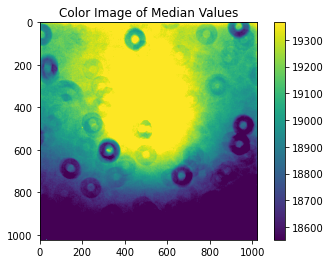

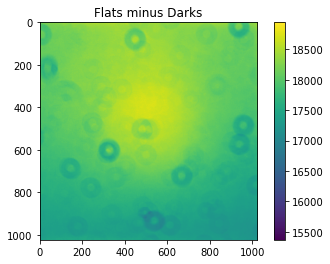

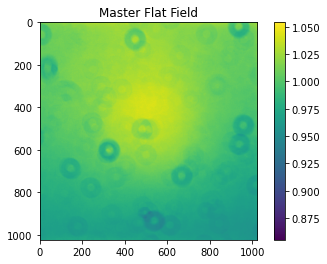

array([[0.85517269, 0.89000502, 0.89103441, ..., 0.90194038, 0.90781069,
        0.871476  ],
       [0.97488796, 1.01926302, 1.01227986, ..., 1.04079674, 1.03932221,
        0.99194245],
       [0.98128687, 1.01712077, 1.01784413, ..., 1.03837629, 1.03384141,
        0.98635036],
       ...,
       [0.93279426, 0.97797613, 0.97497143, ..., 0.96350903, 0.96270221,
        0.92483735],
       [0.93365672, 0.97794831, 0.97561132, ..., 0.96565127, 0.96559563,
        0.92553289],
       [0.91991297, 0.96548435, 0.96339775, ..., 0.94906975, 0.94525822,
        0.91006422]])

In [24]:
### MASTER RED FLAT FIELD ###

master_red = flat_field(red_flat, dark_01sec)
master_red

#### This is the first execution of our master flat field function. As we see the first image is the median of all 5 of our flat field images. We see several donut-like rings throughout the image. These are dust particles on the lens of the telescope itself. When we divide our astro images by the master flats we are able to get rid of these rings from appearing in our image.

#### The second image (like the title says) our 2D image when we subtract the dark frame from the image. We see that the image becomes much sharper and reduces all the dark areas of the image. The third image is our normalized master flat field that will be divided from our actual astro images.

#### The array is simply an output of the master flat field array. Showing that all the values oscillate around 1.

#### The same will be done for the Visible and Blue flat fields below.

mean:22525.250162124634
std:512.9542912769465


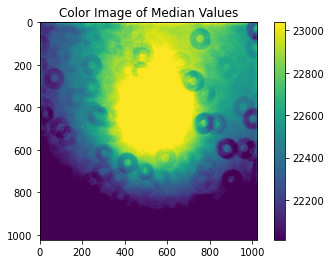

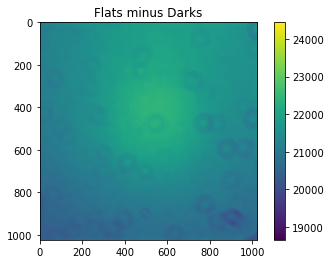

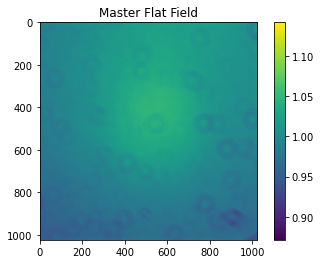

array([[0.87152562, 0.87731618, 0.87724613, ..., 0.8921895 , 0.89179257,
        0.88133221],
       [0.98114928, 0.99672308, 0.98969502, ..., 1.01755041, 1.00921481,
        1.00134618],
       [0.98796719, 0.99072238, 1.00080916, ..., 1.01514546, 1.010499  ,
        1.00076246],
       ...,
       [0.94199297, 0.95712314, 0.95376088, ..., 0.94876419, 0.95065546,
        0.9437208 ],
       [0.9424366 , 0.95369083, 0.95541866, ..., 0.94934791, 0.95182291,
        0.94028849],
       [0.94453801, 0.95831394, 0.95450805, ..., 0.95639932, 0.95114579,
        0.94187622]])

In [25]:
### MASTER GREEN FLAT FIELD ###

master_green = flat_field(green_flat, dark_01sec)
master_green

mean:10144.850317001343
std:218.52281240242766


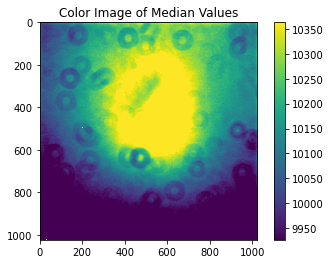

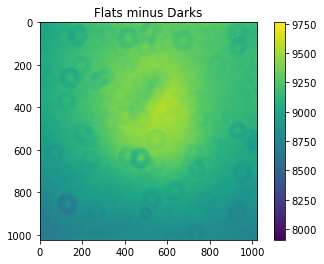

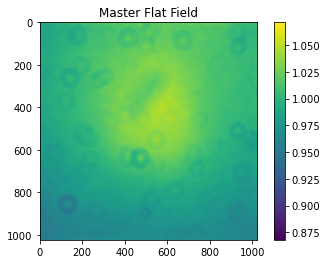

array([[0.8680101 , 0.88397868, 0.88227756, ..., 0.90537987, 0.90351412,
        0.89890464],
       [0.99367347, 0.99109435, 0.98911886, ..., 1.03400647, 1.02868361,
        1.01496491],
       [0.99910608, 0.99899633, 1.00201445, ..., 1.02775074, 1.01688553,
        1.01677578],
       ...,
       [0.94527387, 0.95998032, 0.95838895, ..., 0.95904745, 0.95965108,
        0.95207835],
       [0.95054185, 0.95334047, 0.96168144, ..., 0.96063882, 0.95965108,
        0.94713961],
       [0.95317584, 0.96233994, 0.96826642, ..., 0.96332769, 0.95701708,
        0.95114548]])

In [26]:
### MASTER BLUE FLAT FIELD ###

master_blue = flat_field(blue_flat, dark_1sec)
master_blue

In [27]:
### Save new flat images as FITS files ###

save(master_red, 'MasterRedFlatField')
save(master_green, 'MasterGreenFlatField')
save(master_blue, 'MasterBlueFlatField')

#### Above we are saving our master flat fields so that we can use them later to divide from our astro images.

### 4.3.2. In DS9 we see that there are 0.95 counts in the corners of our flat field images and about 1.05 counts in the middle

$fraction-of-light = \frac{0.95}{1.05} * 100$

#### 90% of the light gets to the corners as opposed to the center. 

### 4.3.3. Applying a 90% change to the flux of the observed star within the apparent magnitude formula:

$m_x = -5log_{100}(\frac{F_1 * 0.90}{F_2})$

#### A star observed in the corner will be observed at 94% the actual brightness.

### 4.3.4. Histogram of the counts of the Red master flat field

max count value: 1.0540397073289318
min count value: 0.8551726897502167
mean: 1.0000000000000002
mode: 1.006910338585459
median: 1.0036274191570471
std: 0.022212988309770386


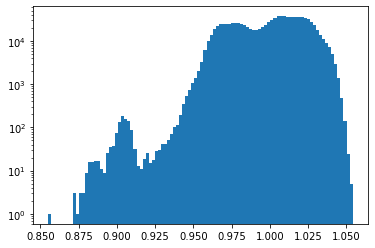

In [28]:
### make 1D array
count = master_red.flatten()

print(f'max count value: {np.max(count)}')
print(f'min count value: {np.min(count)}')

### plot the histogram, using a logarithmic y-axis
plt.hist(count,bins=100);
plt.yscale('log')

### compute the mean, the median, the mode, and the standard deviation:
print(f'mean: {np.mean(count)}')
print(f'mode: {stats.mode(count)[0][0]}')
print(f'median: {np.median(count)}')
print(f'std: {np.std(count)}')

#### We see only a few dead pixels between about 0.850 and 0.87, which is great for when we apply this flat field to our astro image.

### 4.3.5. If you forget to take flats on the night of observing you cannot take them later because on another night the dust particles on the telescope may change so you would have new donut particles blocking other areas of the image and you could not divide these out effectively. 

### Other factors to consider: temperatures may differ from the previous night, and there may be changes in the spontaneous excitement of the electrons in the semi-conductor.

## 4.4 Spectroscopic Calibration

### 4.4.1. The middle slit is the 25 micrometer slit we will use 

### 4.4.2

#### The next step in our data analysis is to analyze our arc lamp data. We used a neon arc lamp to take a spectra of emission lines so that we can do a wavelength calibration of our light sources. The 2D images that we have been creating are plots of flux intensity as a function of pixel position. We want to turn that into counts as a function of wavelength. There are a few steps to do this:

#### First we need to take the normalized applicable flat field of our arc lamp. Below we upload and take the median of our neon arc lamp flat field images and as we see there are 3 distinct bars below. Each of these three bars corresponds to a slit in the spectrometer, but for our intents we are only interested in using the middle 25 micrometer slit. 

mean:4076.1285351787774
std:2593.0235560747665


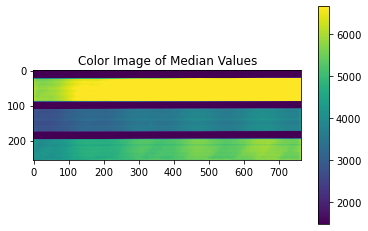

In [29]:
arc_flat = med_image(arclamp)

#### Because we are only interested in using the middle slit, we will slice our numpy array to contain only that slit. to identify where to begin and end our slicing we opened the image into DS9 and manually panned our cursor over to the top left of the rectangle and noted the y position of 108, then panned to the bottom right corner and noted the y-position of 177. We go to the bottom right in case the slit is not perfectly level and hangs down lower than the left side. We slice and rename the slice "slice_flat_arr". 

[[ 420.  395.  398. ... 2803. 2831. 2810.]
 [1547. 1592. 1548. ... 3861. 3884. 3684.]
 [2672. 2534. 2613. ... 4127. 4056. 3919.]
 ...
 [2377. 2324. 2301. ...  753.  783.  722.]
 [ 943.  856.  883. ...  427.  391.  380.]
 [ 301.  288.  283. ...  334.  365.  353.]]


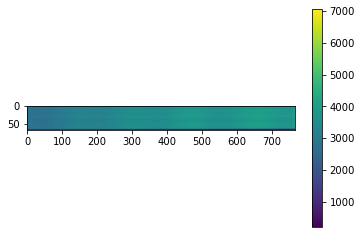

In [30]:
### Flat Field Array of Middle 25 Micrometer Slit Only ###

slice_flat_arr = arc_flat[108:177]
print(slice_flat_arr)

plt.imshow(slice_flat_arr)
plt.colorbar()
plt.show()

#### Now we take the median of the sliced array which gives us a 1D array to plot. We plot the median count values against pixel position which as is expected, ouir frame is 765 pixels wide. The plot below shows this with some slight "wiggles" throughout the curves of the count values.

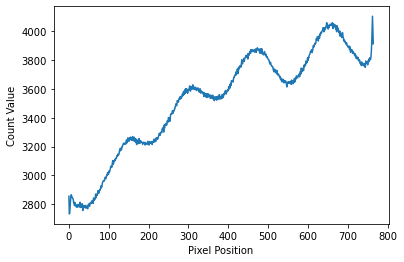

In [31]:
### Plot the 1D Median Flat Field Curve of Counts Vs. Pixel Position ###

flat_arr = np.median(slice_flat_arr, axis = 0)
#print(spec_arr)

plt.plot(flat_arr)
plt.xlabel('Pixel Position')
plt.ylabel('Count Value')
plt.show()

### 4.4.3

#### Our goal is to find a normalized flat field that we would be able to divide from our spectra if our task was to fit a spectral line of some light source. To normalize this flat field we have to first fit a curve to the plot above. The function below uses numpy's "polyfit" function to generate a curve that fits our line and returns the y-values of that fit line. the only parameter that we need to change here is the order of the polynomial. In this case we are using the 30th degree, which may seem a bit high, but it fits the best line. 

In [32]:
### Define Polynomial Fit for Flat Field Curve ###

### Change integer value in np.polyfit for better or worse fitting curve 

x = np.linspace(0,765,765)

a = np.polyfit(x, flat_arr, 30, rcond=None, full=False, w=None, cov=False)

def polynom(x, a):
    at = np.flip(a)
    eq = 0
    for n, an in enumerate(at):
        eq += an * x**n
    return eq
eq = polynom(x, a)

/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


#### The orange line represents the polyfit curve which appears to lie exactly on top of our counts v. pixels plot. The all we do is divide our original plot from the fit and the result is the efficiency of our fit to the original plot. As we see it oscillates very close to 1 so this is a great fit to the curve because values divided by themselves equal 1. So the fit is almost exactly the same as the original.

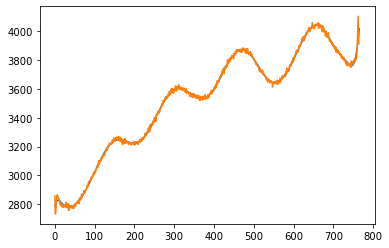

In [33]:
### Flat Field Overlaid with Polynomial Fit of 30 Order ###

plt.plot(x, eq)
plt.plot(flat_arr)
plt.show()

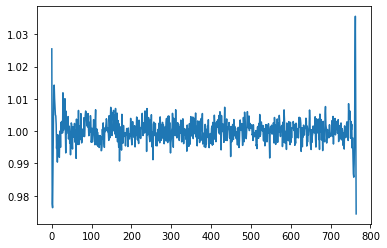

In [34]:
### Residual Plot of the Efficieny of the Fit to the Flat Field, 
### 1 being a perfect match

normed_flat = flat_arr / eq
plt.plot(normed_flat)
plt.show()

#### To obtain our master normalized flat field for the arc lamp flats we simply divide our 2D slice array by the fitted curve, yielding the image below which we see is more solid in color and continuous than the original image which had periodice dark spots about every 100th pixel or so. 

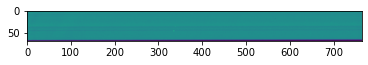

In [35]:
### Normalizing the Flat Field by dividing by Median Flat Field 
### to obtain True Normalized Master Flat Field 

master_flat_lamp = slice_flat_arr / eq

plt.imshow(master_flat_lamp)
plt.show()

### 4.4.4

#### Now we will work with the actual arclamp data itself. Following the same procedure before, we open all the arc lamp images and take their median and plot the resulting image. We only care about the middle slit so we slice that out.

mean:156.13491733948482
std:435.9799096758489


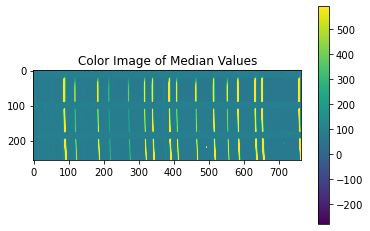

[[ 90.  86.  84. ...  64.  87.  97.]
 [104. 109. 122. ... 154.  84.  90.]
 [120. 117. 122. ... 143.  97.  74.]
 ...
 [100.  88. 102. ... 513. 173. 127.]
 [121.  85.  86. ... 122. 110.  55.]
 [ 84. 113.  97. ...  93.  88.  76.]]


<function matplotlib.pyplot.show(close=None, block=None)>

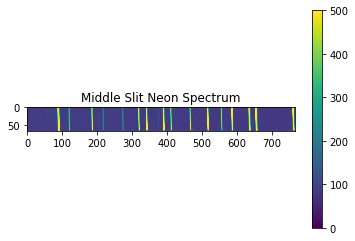

In [36]:
NE_lamp = med_image(neon)
NE_lamp

slice_arr = NE_lamp[108:177]
print(slice_arr)
plt.imshow(slice_arr, vmax = 500)
plt.title('Middle Slit Neon Spectrum')
plt.colorbar()
plt.show

#### To normalize the neon arc lamp spectrum we simply divide our sliced array by the master flat lamp array obtained before. This is our final Neon spectrum. Save it to the folder.

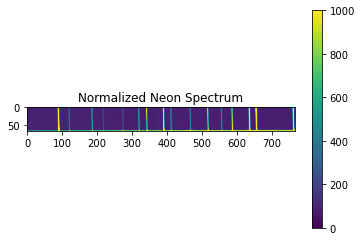

In [37]:
neon_normalized_arclamp_spec = slice_arr / master_flat_lamp

save(neon_normalized_arclamp_spec, "Ne_Spectrum_Final")

plt.imshow(neon_normalized_arclamp_spec, vmax = 1000)
plt.title(f'Normalized Neon Spectrum')
plt.colorbar()
plt.show()

### 4.4.5

#### We take the median of our final image again in order to make it a 1D array of count values that we can plot, and we plot the counts v. pixel position. Comparing this result tio the known spectra of neon, we can see that the emission lines peak at the same points as our plot. We want to calibrate the wavelength though, so we need to transform pixel position into wavelength. In order to do that we must find the pixel position for each emission peak. 

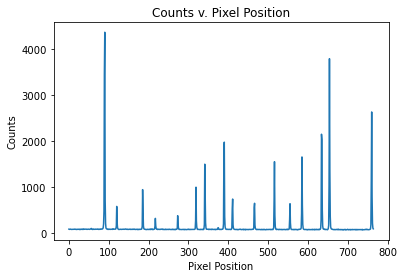

In [38]:
spec_arr = np.median(slice_arr, axis = 0)
#print(spec_arr)

plt.plot(spec_arr)
plt.xlabel('Pixel Position')
plt.ylabel('Counts')
plt.title('Counts v. Pixel Position')
plt.show()

#### This function below will take a range of pixel positions and output the pixel position that has the peak count value and also output what that count value is and place these pixel positions into a new array.

In [39]:
pixels = []
w = []

def peak(o,p):
    u = np.argmax(spec_arr[o:p])
    print(f'count value: {spec_arr[u+o]}')
    print(f'index: {u + o}')
    pixels.append(u + o)
    w.append(spec_arr[u+o])

    return

peak(0,100)
peak(100,150)
peak(150,200)
peak(200,240)
peak(250,300)
peak(300,320)
peak(320,375)
peak(350,400)
peak(400,430)
peak(450,500)
peak(500,530)
peak(530,560)
peak(560,600)
peak(600,640)
peak(640,700)
peak(700,765)

count value: 4374.0
index: 90
count value: 588.0
index: 120
count value: 953.0
index: 185
count value: 328.0
index: 217
count value: 386.0
index: 273
count value: 1006.0
index: 319
count value: 1506.0
index: 341
count value: 1985.0
index: 390
count value: 748.0
index: 411
count value: 656.0
index: 466
count value: 1560.0
index: 516
count value: 646.0
index: 555
count value: 1663.0
index: 585
count value: 2157.0
index: 634
count value: 3799.0
index: 654
count value: 2641.0
index: 760


#### Our array of pixel positions below. We will plot this againts the range of wavelengths we expect neon to emit is which is 4000 - 7500 Angstroms and this range is defined by the "lam" variable.

In [40]:
lam = np.linspace(4000, 7500, len(pixels))
print(f'lam:{lam}')
print(f'pixels:{pixels}')

lam:[4000.         4233.33333333 4466.66666667 4700.         4933.33333333
 5166.66666667 5400.         5633.33333333 5866.66666667 6100.
 6333.33333333 6566.66666667 6800.         7033.33333333 7266.66666667
 7500.        ]
pixels:[90, 120, 185, 217, 273, 319, 341, 390, 411, 466, 516, 555, 585, 634, 654, 760]


#### We want to fit a line to our wavelength v. pixel position plot which will give us an equation of y = mx + b, where y is wavelength, m and b are given by the fit, and by inputting the pixel positions (x) we can figure out the exact wavelengths at each pixel position and plot count values v. wavelength.

#### "c" outputs the m and b coefficients respectively.

#### This fit function returns the value of the wavelength.

In [41]:
c = np.polyfit(pixels, lam, 1)
c

array([   5.51751092, 3502.9936795 ])

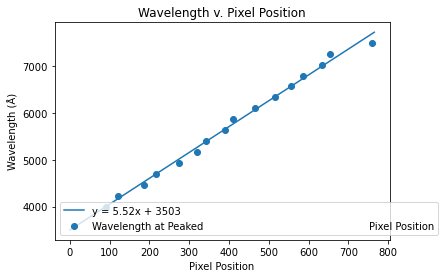

In [42]:
def fit(g):
    fit = c[0]*g + c[1]
    return fit

wavelength = fit(x)

plt.scatter(pixels, lam, marker="o", label = 'Wavelength at Peaked \
                                                    Pixel Position')
plt.plot(x,fit(x), label = 'y = 5.52x + 3503')
plt.ylabel('Wavelength (\u212B)')
plt.xlabel('Pixel Position')
plt.title('Wavelength v. Pixel Position')
plt.legend()
plt.show()

### 4.4.6

#### Now we will just plot the counts v. wavelength that we just derived and obtain our calibrated spectrum of Neon.

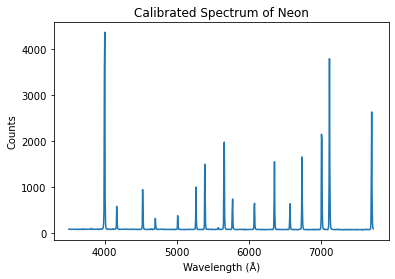

In [43]:
plt.plot(wavelength, spec_arr)
plt.xlabel('Wavelength (\u212B)')
plt.ylabel('Counts')
plt.title('Calibrated Spectrum of Neon')
plt.show()

### 4.4.7 

#### The length of the spectrum is 3500 to 7500 Angstroms (A). Our dispersion ranges from 4000 to 7500 A with about 100-200 A in between each emission line.

### 4.5 Calibration Strategies

#### So far we have completed 2 calibration strategies. One was to normalize our flat fields and take teh median of our dark frames for the case of photometry, and the other was for calibration of the wavelengths to corresponding counts using an arc lamp of known emission lines such as neon or mercury. 

#### The first is useful for caputring images and data regarding the flux of a light source and the latter is useful for determining the spectra and (thereby the composition) of the light source.

#### The calibration exposure that must be taken the same day for both types of observations is the flat fields for each filter and the flat fields for the arc lamp spectra. As discussed before, the flat fields change based on the dust particles that block the lens and also the twighlight field (or dome ceiling in our case) that serves as the flat image. The spectrometer is also a very sensitive instrument and if the mirrors are not exactly aligned to the same position on both nights then the calibration will not be the same.  

#### The same goes for the dark frames, since we are measuring the dark current of the CCD, variables in the ambient temperature from day to day can lead to more hot pixels than the night before or less. Either ay they need to be taken the same day as observations.

#### If there was an observation that needed to be taken the next day, you could get away with taking another bias frame which is a 0 second exposure to see how spontaneous the electrons are. That should not change much if at all in a day. 

### 4.6 Make a Pretty Image

#### Finally, we can begin working with our actual data images of the Pleiades star cluster. We will open the files, take the median, and and define those new images. From there we will subtract the darks with the same exposure times and divide by the respective RGB master flat fields we computed for each filter.

mean:999.6229429244995
std:142.4041777188582


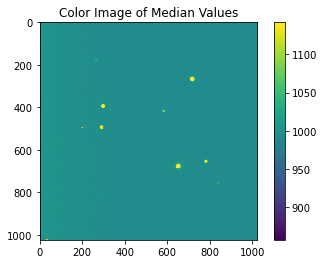

mean:1003.409761428833
std:144.63975024839866


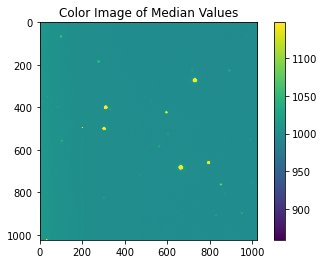

mean:1009.5713958740234
std:228.74214771534585


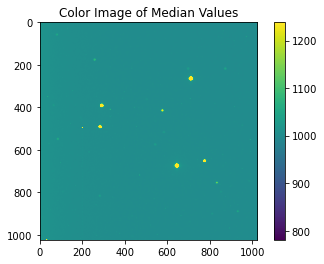

In [46]:
P_b = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/Flat_Fields/P_blue/*'
P_r = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/Flat_Fields/P_red/*'
P_v = r'/Users/adamfletcher/Desktop/AST_443.nosync/LAB_1_ACTUAL/Lab_1/Flat_Fields/P_visible/*'


P_blue_master = med_image(P_b)
P_red_master = med_image(P_r)
P_vis_master = med_image(P_v)

In [47]:
Blue = (P_blue_master - dark_1sec) / master_blue
Red = (P_red_master - dark_01sec) / master_red
Vis = (P_vis_master - dark_01sec) / master_green

#### Plot each of the final images. These are the images that we will lay on top of each other and adjust the saturation levels of each to obtain the final image.

<function matplotlib.pyplot.show(close=None, block=None)>

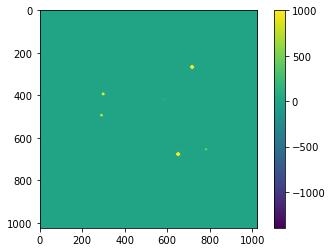

In [48]:
plt.imshow(Blue, vmax = 1000)
plt.colorbar()
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

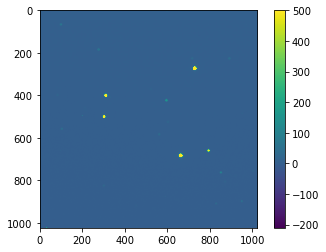

In [49]:
plt.imshow(Red, vmax = 500)
plt.colorbar()
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

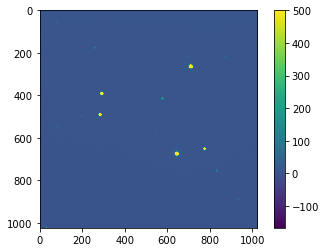

In [50]:
plt.imshow(Vis, vmax = 500)
plt.colorbar()
plt.show

#### Now we save our images using our save function and then open them into DS9 to lay them on top of each other and to adjust the color scale to give us our final image.

In [51]:
### Save new flat images as FITS files ###

save(Blue, 'Blue_Final')
save(Red, 'Red_Final')
save(Vis, 'Vis_Final')

#### We are ready to produce our final image now. We will lay the Red, Blue, and Visible images on top of each other and calibrate the saturation of each filter band until we get a black background. This will be the final image. We will use DS9 to do this, but first we need to upload all three images to Astrometry.net for WCS calibration. This will auto align all of the stars in the images to be in the same position so they truly lay on top of each other. to do that we go to Astrometry.net and upload the images which looks like:

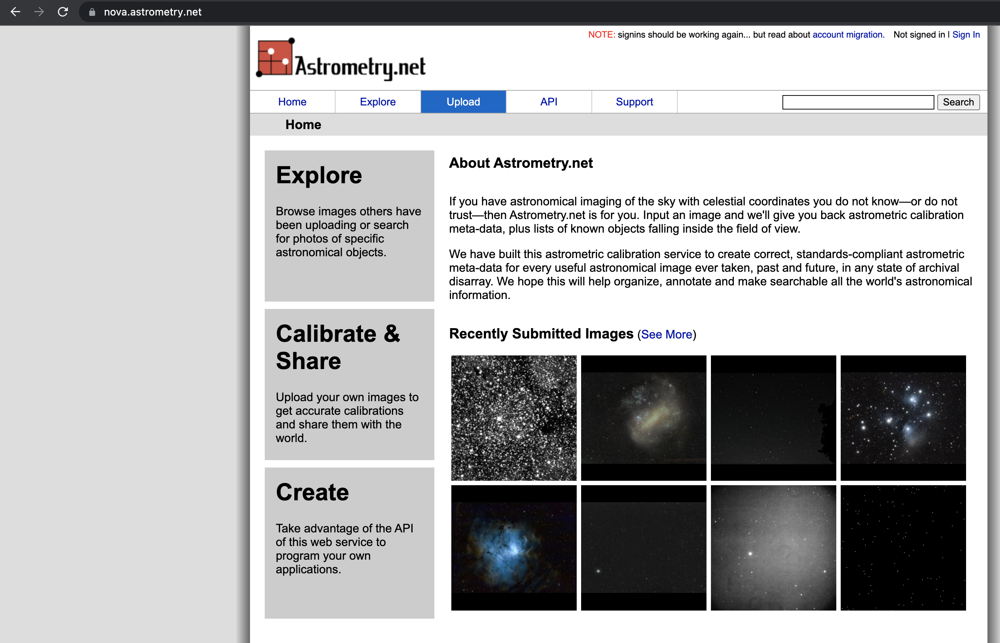

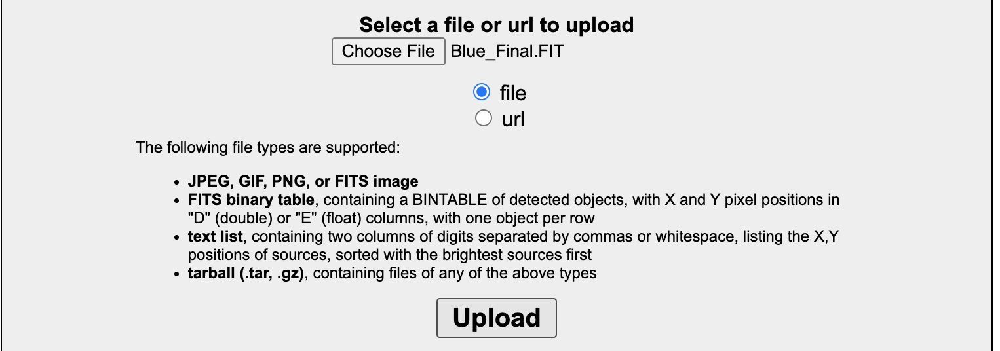

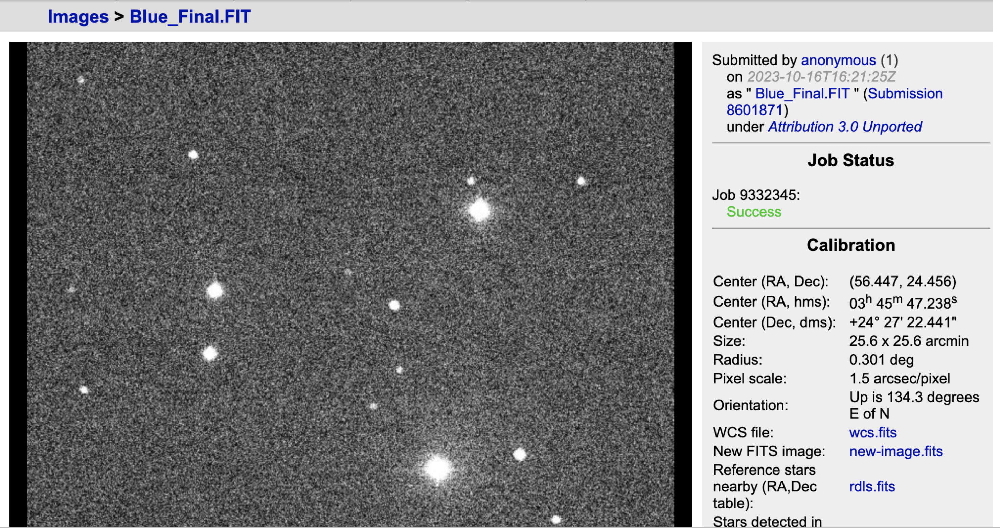

#### From here download the "new-image.fits" file and this will be the calibrated blue image that you will open later. Do this for the Red and the Green images as well.

#### Once you have all your new calibrated files downloaded, open DS9 and then go to the "Frame" drop-down tab and select "New Frame RGB". 

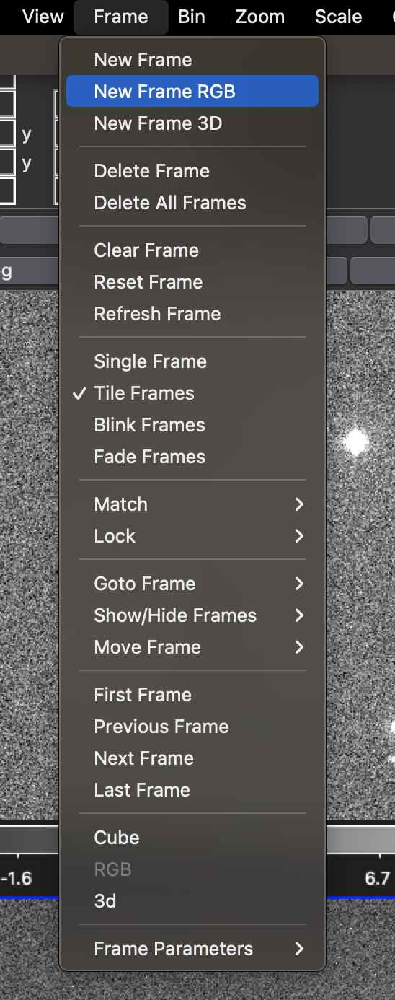

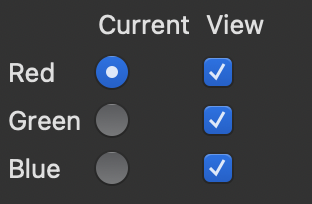

#### With the Red box selected, go to File > Open > open your Red WCS calibrated image. Repeat for Green and Blue.



#### Make sure that the WCS tab is set to degrees (you may need to disable the FK5 tab to allow for alignment as well). The resulting image should look like:

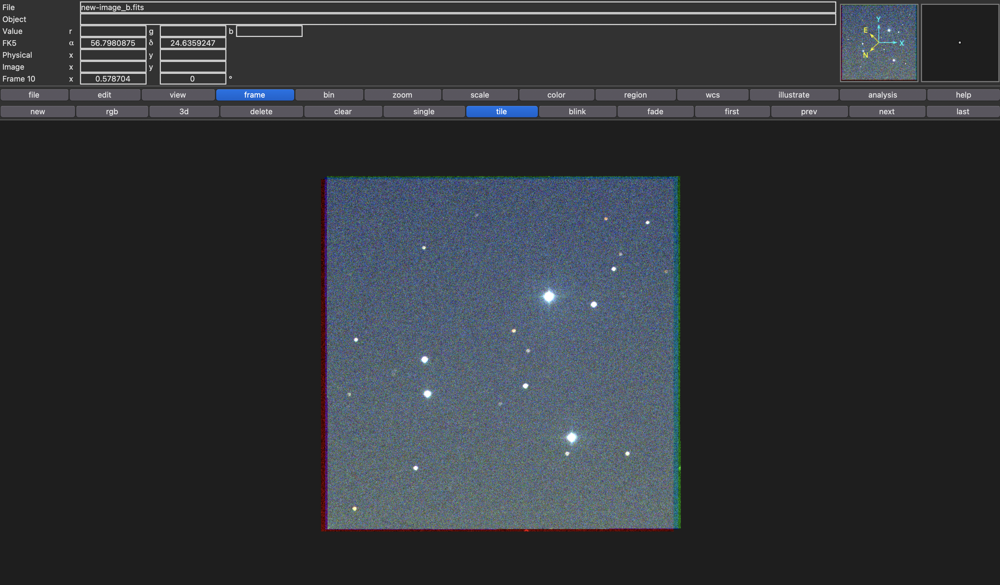

#### Now all the images are open on top of each other and you may see some overlap on either side. This is why we did the WCS calibration. Now go to Scale > Scale parameters and adjust the color balance for each frame. We are trying to adjust the scale until the background of space is black. This will give us the correct colors of the objects in the image.

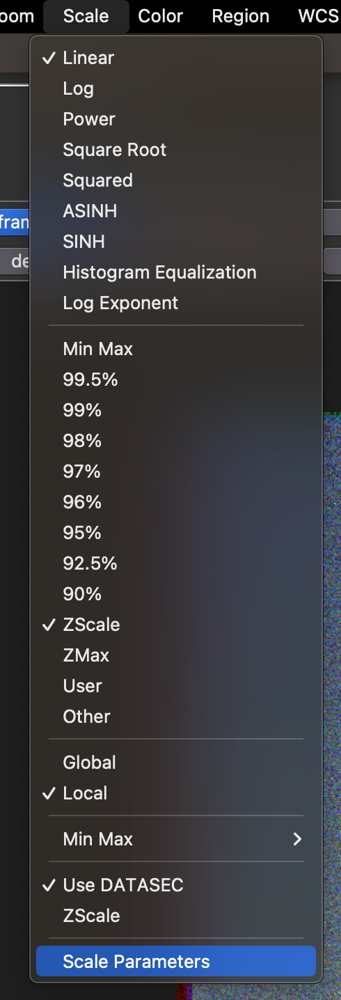

#### The following box will pop up. From here you adjust the maximum values, switching between the RGB tab so you adjust each filter color individually. This is a modified image after updating the blue and red parameters:

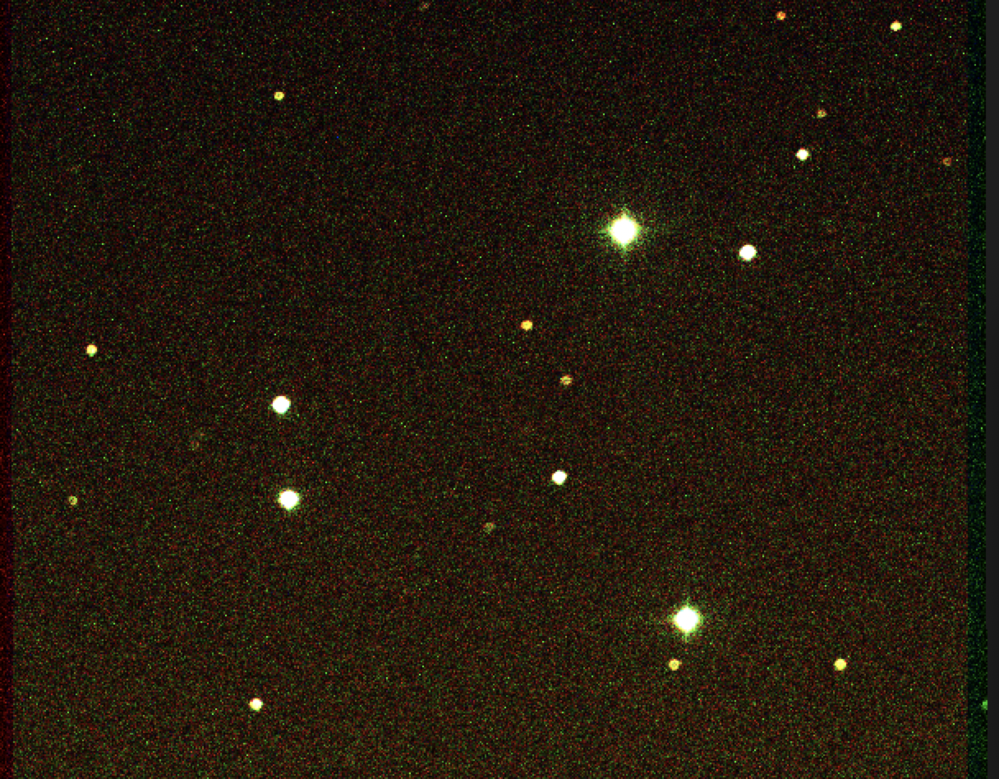

#### And the final image after adjusting the scale so all the colors blend smoothly we obtain our final calibrated and noise reduced image:

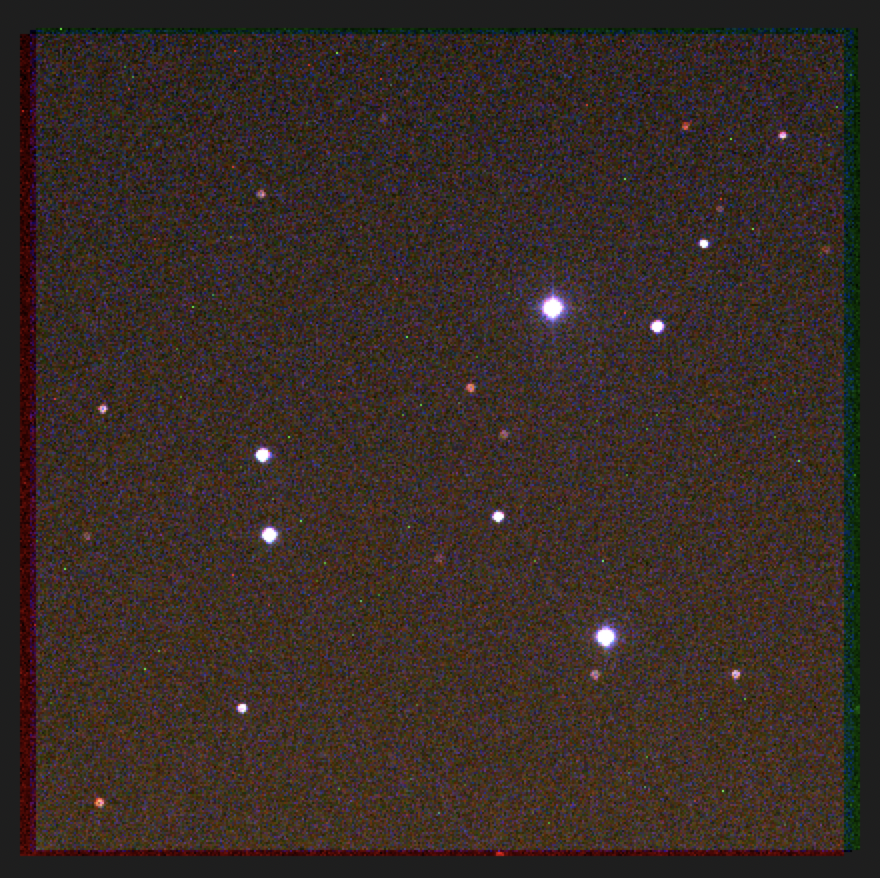

#### It is important to note that there are still dead pixels which are the individual green specs throughout the image. These are unavoidable and vary from CCD to CCD. They are small enough that they are of no consequence to our overall image.

#### And there we have our pretty image. There are many steps along the way where imperfections may arise. We only took 0.1 second exposures for the red and green filters but a full 1 second exposure for the blue filter. We can see a large difference in noise reduction from the 1 second blue filter and had we applied this to the red and green filter exposures, I believe our image could have come out even more clear. In future labs I will make sure to be consistent with exposure times.

#### Another point of reduction imperfection came from our histogram plot of the normalized red flat fields. Even with all the noise reduction and dust cancellation there were still some stray pixels that were outside the Gaussian distribution of the counts that could not be completely erased.

#### The final imperfection to point out is the eyeball analysis of where middle slit lies for the spectroscopic calibration. Mentioned before, in order to find where the top of the slit begins and ends, we had to open the image into DS9, and pan over with the mouse and zoom in to the top of the slit. The nwe had to decide which row was going to be the top of the slit. The problem is that even when zoomed in, the lines become blurred gray and determing which row it begins on becomes a matter of opinion based on who is looking at it. Though this is a relatively minor imperfection and hardly affects the outcome of the calibrted spectrum, it is worth noting.

#### Overall, we were successful in capturing precise data during our lab time and we successfully reduced and calibrated our images to give us our desired "Pretty Picture" of the bottom corner of the Pleiades constellation. The four brightest blue stars make up the part of the constellation and we can see that fainter red and yellow stars were also captured in the background as an added bonus the the beauty of our picture.